# Import modules

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tools import read_merged_data
import warnings

warnings.filterwarnings("ignore")
random_state = 42
np.random.seed(random_state)

# Load Data

In [2]:
merged_data = read_merged_data(124)
merged_df = pd.concat(merged_data, axis = 0)
merged_df.head()

Opening UoB_Set01_2025-01-02tapes.csv
Opening UoB_Set01_2025-01-03tapes.csv
Opening UoB_Set01_2025-01-06tapes.csv
Opening UoB_Set01_2025-01-07tapes.csv
Opening UoB_Set01_2025-01-08tapes.csv
Opening UoB_Set01_2025-01-09tapes.csv
Opening UoB_Set01_2025-01-10tapes.csv
Opening UoB_Set01_2025-01-13tapes.csv
Opening UoB_Set01_2025-01-14tapes.csv
Opening UoB_Set01_2025-01-15tapes.csv
Opening UoB_Set01_2025-01-16tapes.csv
Opening UoB_Set01_2025-01-17tapes.csv
Opening UoB_Set01_2025-01-20tapes.csv
Opening UoB_Set01_2025-01-21tapes.csv
Opening UoB_Set01_2025-01-22tapes.csv
Opening UoB_Set01_2025-01-23tapes.csv
Opening UoB_Set01_2025-01-24tapes.csv
Opening UoB_Set01_2025-01-27tapes.csv
Opening UoB_Set01_2025-01-28tapes.csv
Opening UoB_Set01_2025-01-29tapes.csv
Opening UoB_Set01_2025-01-30tapes.csv
Opening UoB_Set01_2025-01-31tapes.csv
Opening UoB_Set01_2025-02-03tapes.csv
Opening UoB_Set01_2025-02-04tapes.csv
Opening UoB_Set01_2025-02-05tapes.csv
Opening UoB_Set01_2025-02-06tapes.csv
Opening UoB_

,Incoming bid,Incoming ask,Outgoing bid,Outgoing ask,alpha,beta,LOB,mid_price,low_ask,high_bid,Volume,Tapes Price,Last Tapes Price
combined_time,,,,,,,,,,,,,
2025-01-02 08:00:00,[1 6],,,,NaN,NaN,"[['bid', [[1, 6]]], ['ask', []]]",NaN,NaN,1.0,NaN,NaN,NaN
2025-01-02 08:00:01,[261 1],[800 1][799 1][798 1][797 1],,[800 1][799 1][798 1],0.002986,0.015020,"[['bid', [[261, 1], [1, 6]]], ['ask', [[797, 1...",529.0,797.0,261.0,NaN,NaN,NaN
2025-01-02 08:00:02,[262 6],[338 3][297 5],[1 6],,0.238553,0.165031,"[['bid', [[262, 6], [261, 1]]], ['ask', [[297,...",279.5,297.0,262.0,NaN,NaN,NaN
2025-01-02 08:00:03,[263 6][264 6],[296 1][309 3][334 4][292 5][291 1][296 4],[262 6][263 6],[338 3][297 5][797 1][296 1] [309 3],0.524854,0.429582,"[['bid', [[264, 6], [261, 1]]], ['ask', [[291,...",277.5,291.0,264.0,NaN,NaN,NaN
2025-01-02 08:00:04,,[288 5][307 4][287 1] [296 3][287 4][300 4][28...,,[292 5][334 4][296 4][287 1] [296 3][307 4][29...,0.820913,0.541382,"[['bid', [[264, 6], [261, 1]]], ['ask', [[286,...",275.0,286.0,264.0,NaN,NaN,NaN


# Prepare Samples

In [3]:
def generate_sample(day, day_index, rnd, sizings, sample_index, sampling_rate) -> pd.DataFrame:
    train_start_time = day.index[rnd] # when referencing start <= segment < end
    train_end_time = day.index[rnd + sizings[0]]
    test_end_time1 = day.index[rnd + sizings[1]]
    test_end_time2 = day.index[rnd + sizings[2]]
    test_end_time3 = day.index[rnd + sizings[3]]
    row = {"sample_index": sample_index,
           "train_size (s)": sizings[0],
           "day_index": day_index,
           "train_start_time": train_start_time,
           "train_end_time": train_end_time,
           "test_end_time1": test_end_time1,
           "test_end_time2": test_end_time2,
           "test_end_time3": test_end_time3,
           "sampling_rate (s)": sampling_rate}
    row = pd.DataFrame([row])
    return row

# extract intra day segments
# train/test size

sample_index = 0
indicies = pd.DataFrame()
for i, d in enumerate(merged_data):
    print(i, end = "\r")
    N = len(d)
    # random samples (3 each)

    for _ in range(100):
        # 1 min / 1s,10s,20s - (60,61,70,80)
        sizings = (60,61,70,80)
        row = generate_sample(d, i, np.random.randint(0,N - sizings[3]), sizings, sample_index, 1)
        indicies = pd.concat([indicies, row], axis = 0)
        sample_index += 1

        """
        # 12 min / 12s,2min,4min
        sizings = (12*60, 12*60+12, 14*60, 16*60)
        row = generate_sample(d, i, np.random.randint(0,N - sizings[3]), sizings, sample_index, 1)
        indicies = pd.concat([indicies, row], axis = 0)
        sample_index += 1

        # 60 min / 1min,10min,20min
        sizings = (60*60, 61*60, 70*60, 80*60)
        row = generate_sample(d, i, np.random.randint(0,N - sizings[3]), sizings, sample_index, 2)
        indicies = pd.concat([indicies, row], axis = 0)
        sample_index += 1

    # fixed samples
    # 3hr / 3min,30min,1hr
    # start_times = (8:00, 10:15, 12:30)
    sizings = (60*60*3, 60*60*3 + 3*60, 60*60*3 + 30*60, 60*60*4)
    row = generate_sample(d, i, 0, sizings, sample_index, 5) # 8:00
    indicies = pd.concat([indicies, row], axis = 0)
    sample_index += 1

    sizings = (60*60*3, 60*60*3 + 3*60, 60*60*3 + 30*60, 60*60*4)
    row = generate_sample(d, i, 15*60*9, sizings, sample_index, 5) # 10:15
    indicies = pd.concat([indicies, row], axis = 0)
    sample_index += 1

    sizings = (60*60*3, 60*60*3 + 3*60, 60*60*3 + 30*60, 60*60*4)
    row = generate_sample(d, i, 30*60*9 - 1, sizings, sample_index, 5) # 12:30
    indicies = pd.concat([indicies, row], axis = 0)
    sample_index += 1
    """

indicies.index = indicies["sample_index"]
indicies.drop("sample_index", axis = 1, inplace=True)
indicies

,train_size (s),day_index,train_start_time,train_end_time,test_end_time1,test_end_time2,test_end_time3,sampling_rate (s)
sample_index,,,,,,,,
0,60,0,2025-01-02 14:34:14,2025-01-02 14:35:14,2025-01-02 14:35:15,2025-01-02 14:35:24,2025-01-02 14:35:34,1
1,60,0,2025-01-02 12:23:15,2025-01-02 12:24:15,2025-01-02 12:24:16,2025-01-02 12:24:25,2025-01-02 12:24:35,1
2,60,0,2025-01-02 08:14:20,2025-01-02 08:15:20,2025-01-02 08:15:21,2025-01-02 08:15:30,2025-01-02 08:15:40,1
3,60,0,2025-01-02 09:29:50,2025-01-02 09:30:50,2025-01-02 09:30:51,2025-01-02 09:31:00,2025-01-02 09:31:10,1
4,60,0,2025-01-02 16:16:42,2025-01-02 16:17:42,2025-01-02 16:17:43,2025-01-02 16:17:52,2025-01-02 16:18:02,1
...,...,...,...,...,...,...,...,...
12495,60,124,2025-07-01 08:14:24,2025-07-01 08:15:24,2025-07-01 08:15:25,2025-07-01 08:15:34,2025-07-01 08:15:44,1
12496,60,124,2025-07-01 11:20:55,2025-07-01 11:21:55,2025-07-01 11:21:56,2025-07-01 11:22:05,2025-07-01 11:22:15,1
12497,60,124,2025-07-01 09:29:49,2025-07-01 09:30:49,2025-07-01 09:30:50,2025-07-01 09:30:59,2025-07-01 09:31:09,1


# 60s 

In [4]:
sixty_df = pd.DataFrame()

for i, row in indicies[indicies["train_size (s)"] == 60].iterrows():
    print(i, end = "\r")
    segment = merged_df[(merged_df.index >= row["train_start_time"]) & (merged_df.index < row["train_end_time"])]
    x = {}
    for col in list(segment.columns):
        s = segment[col]
        if col in ["alpha", "beta"]:
            x[col] = s.fillna(0).mean()
        elif col in ["low_ask", "mid_price", "high_bid", "Last Tapes Price"]:
            x[col] = s.mean() / 400
            
        elif col in ["Volume"]:
            x[col] = s.fillna(0).mean() / 5

        if col in ["alpha", "beta", "low_ask", "mid_price", "high_bid", "Last Tapes Price", "Volume", "Tapes Price"]:
            s = s.dropna()
            x[col+"_trend"] = np.polyfit(s.index.astype(np.int64) // 10**9,s, deg = 1)[0]

    x["y1"] = merged_df.loc[row["test_end_time1"]]["Last Tapes Price"] >= merged_df.loc[row["train_end_time"]]["Last Tapes Price"]
    x["y2"] = merged_df.loc[row["test_end_time2"]]["Last Tapes Price"] >= merged_df.loc[row["train_end_time"]]["Last Tapes Price"]
    x["y3"] = merged_df.loc[row["test_end_time3"]]["Last Tapes Price"] >= merged_df.loc[row["train_end_time"]]["Last Tapes Price"]

    sixty_df = pd.concat([sixty_df, pd.DataFrame([x])])

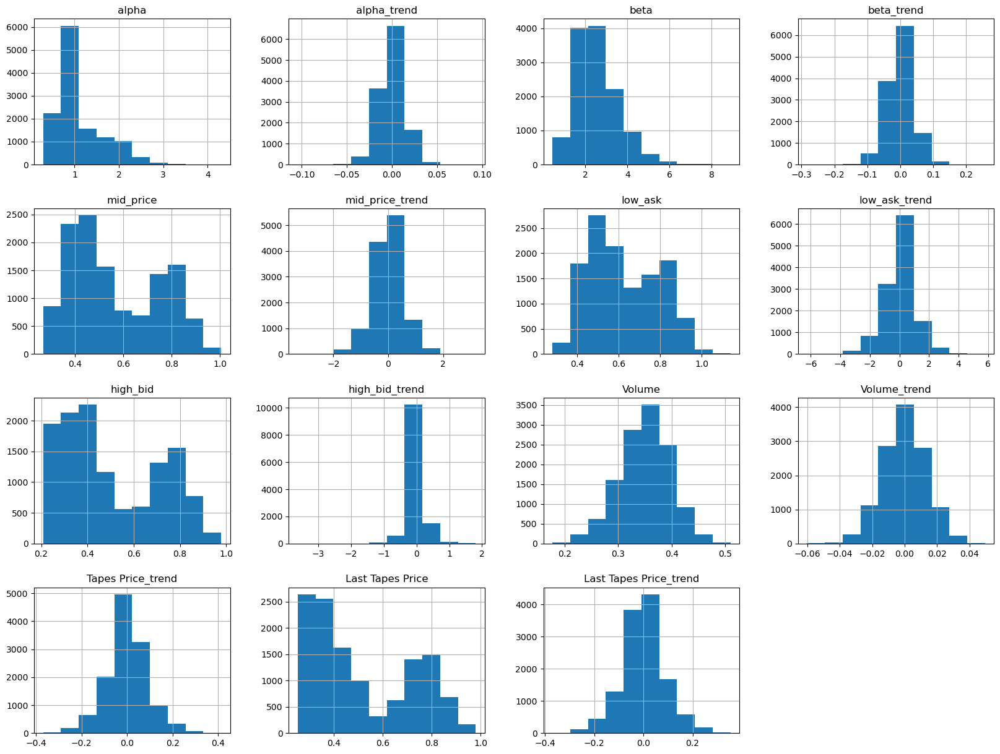

In [5]:
sixty_df.hist(figsize=(20,15))
plt.show()

# Logistic Regression

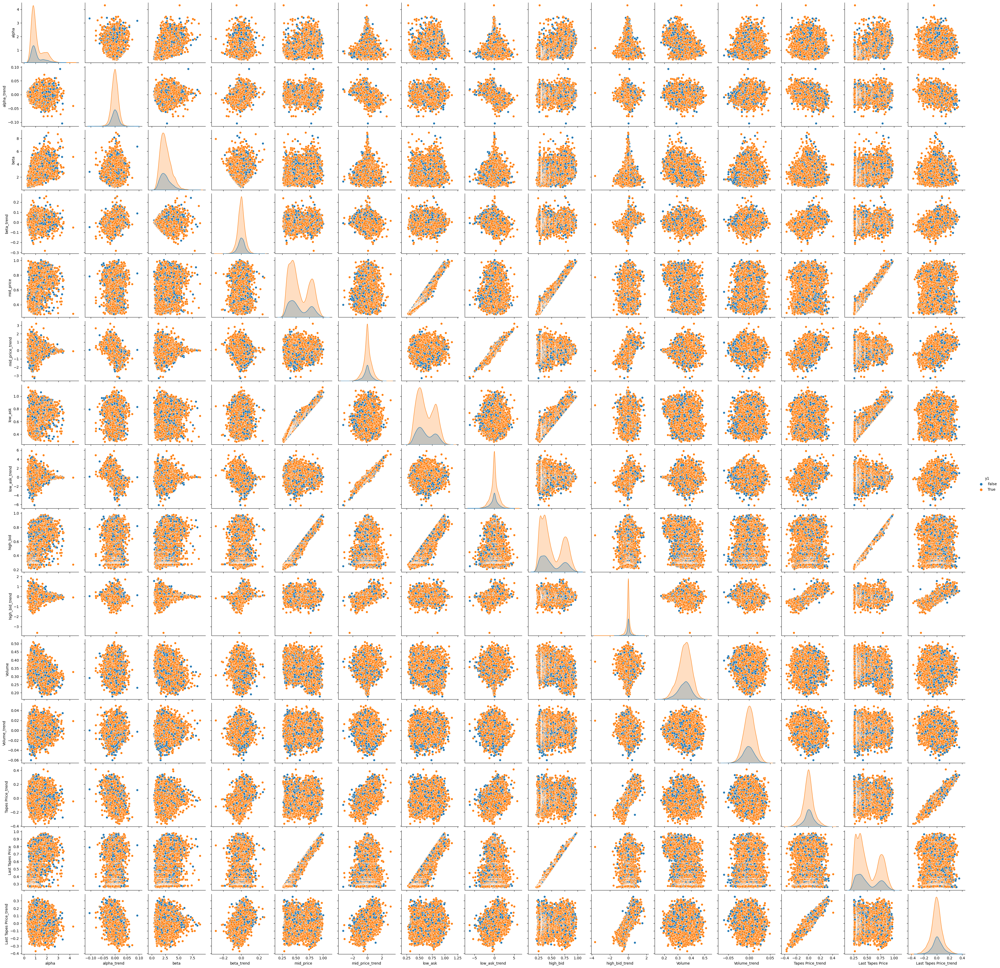

Baseline:  0.77328
0.774


In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

x_feats = list(sixty_df)
y_feat = "y1"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")

# Create pair plot
sns.pairplot(sixty_df, vars = x_feats, hue = y_feat)
plt.show()

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = LogisticRegression(random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

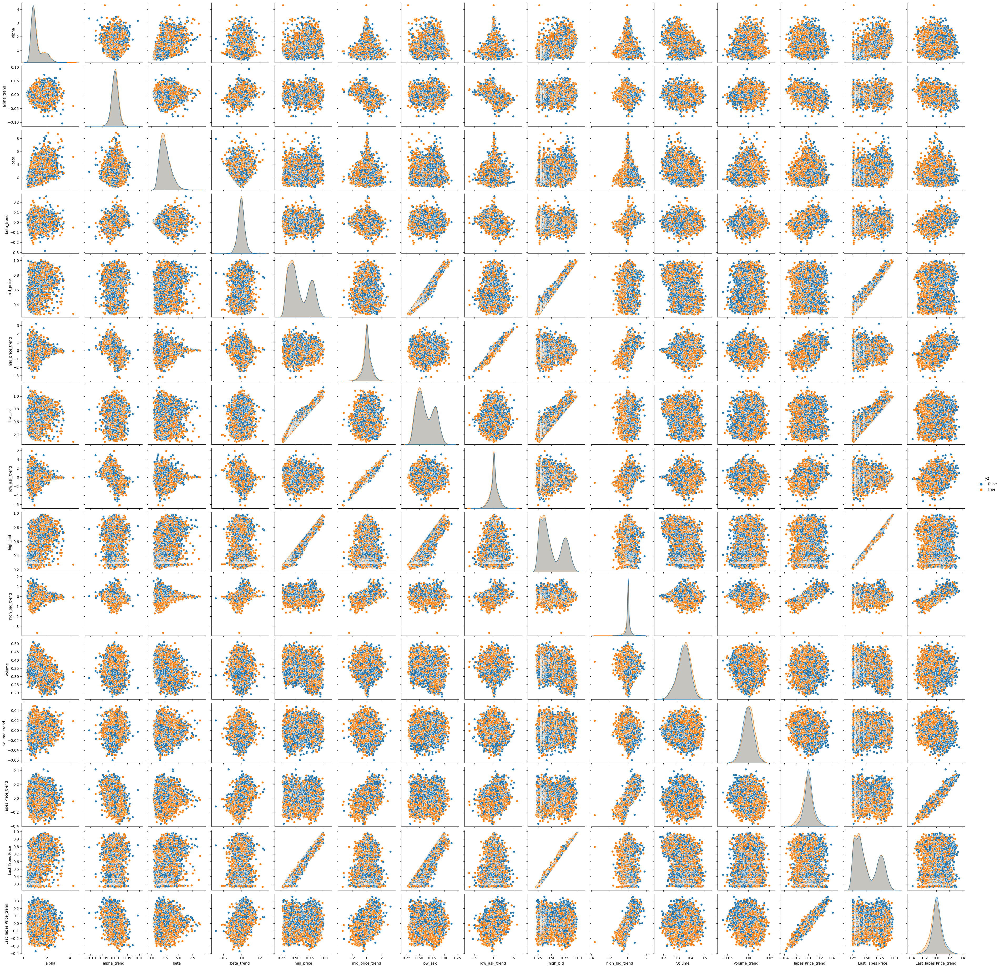

Baseline:  0.50696
0.5796


In [7]:
x_feats = list(sixty_df)
y_feat = "y2"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")


# Create pair plot
sns.pairplot(sixty_df, vars = x_feats, hue = y_feat)
plt.show()

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = LogisticRegression(random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

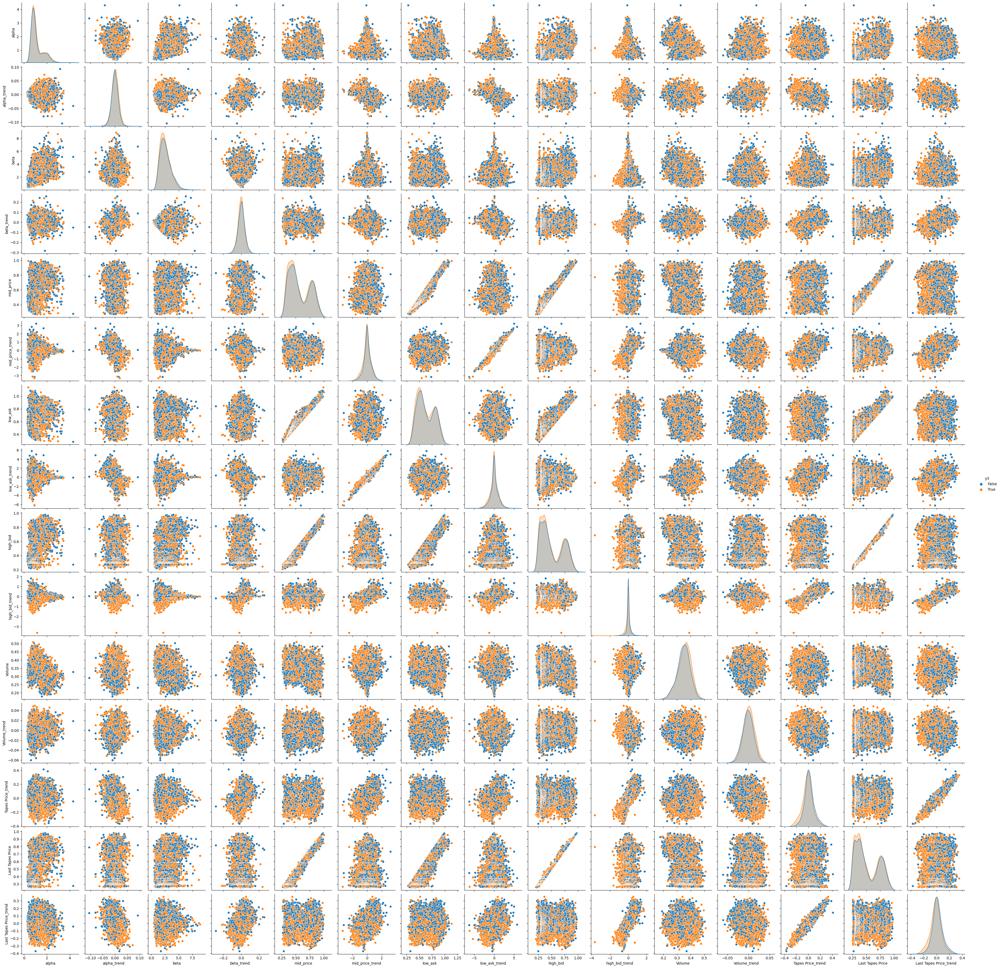

Baseline:  0.5144
0.5732


In [8]:
x_feats = list(sixty_df)
y_feat = "y3"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")


# Create pair plot
sns.pairplot(sixty_df, vars = x_feats, hue = y_feat)
plt.show()

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = LogisticRegression(random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

# SVC

In [15]:
from sklearn.svm import SVC

x_feats = list(sixty_df)
y_feat = "y1"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = SVC(kernel='rbf', random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

Baseline:  0.77328
0.776


In [16]:
from sklearn.svm import SVC

x_feats = list(sixty_df)
y_feat = "y2"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = SVC(kernel='rbf', random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

Baseline:  0.50696
0.566


In [17]:
from sklearn.svm import SVC

x_feats = list(sixty_df)
y_feat = "y3"
x_feats.remove("y1")
x_feats.remove("y2")
x_feats.remove("y3")

X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

clf = SVC(kernel='rbf', random_state=random_state)

clf.fit(X_train, y_train)

ypred = clf.predict(X_test)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

Baseline:  0.5144
0.552


# Insights


In [19]:

from sklearn.preprocessing import StandardScaler
y_feat = "y2"
X_train, X_test, y_train, y_test = train_test_split(sixty_df[x_feats], sixty_df[y_feat], test_size=0.2)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

clf = LogisticRegression(random_state=random_state)

clf.fit(X_train_scaled, y_train)

ypred = clf.predict(X_test_scaled)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

# Extracting coefficients and feature names
coefficients = clf.coef_[0]
feature_names = X_train.columns

# Printing feature importance (absolute values of coefficients)
feature_importance = {feature_names[i]: abs(coefficients[i]) for i in range(len(feature_names))}
print("Feature Importance:")
for feature, importance in sorted(feature_importance.items(), key=lambda x: x[1], reverse=True):
    print(feature, importance)

Baseline:  0.50696
0.5848
Feature Importance:
Last Tapes Price 1.8090534609452238
high_bid 1.2988597722314938
mid_price 0.6624607105810519
Tapes Price_trend 0.3232725098857789
Volume_trend 0.19712885159050292
low_ask_trend 0.18609974025674814
Volume 0.1842815375200863
mid_price_trend 0.16756092435339312
high_bid_trend 0.15229444255652852
low_ask 0.14937218344308104
alpha 0.09827704833963066
Last Tapes Price_trend 0.09720278644017069
beta_trend 0.09689962986890761
beta 0.02881472219845197
alpha_trend 0.0213440419316396


In [35]:
new_x_feats = ["Tapes Price_trend", "Volume_trend"]
new_y_feat = "y2"

X_train, X_test, y_train, y_test = train_test_split(sixty_df[new_x_feats], sixty_df[new_y_feat], test_size=0.2)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

clf = LogisticRegression(random_state=random_state)

clf.fit(X_train_scaled, y_train)

ypred = clf.predict(X_test_scaled)

print("Baseline: ", np.mean(sixty_df[y_feat] == True))
print(accuracy_score(ypred, y_test))

# Extracting coefficients and feature names
coefficients = clf.coef_[0]
feature_names = X_train.columns

# Printing feature importance (absolute values of coefficients)
feature_importance = {feature_names[i]: abs(coefficients[i]) for i in range(len(feature_names))}
print("Feature Importance:")
for feature, importance in sorted(feature_importance.items(), key=lambda x: x[1], reverse=True):
    print(feature, importance)

Baseline:  0.50696
0.5644
Feature Importance:
Tapes Price_trend 0.28820496869952333
Volume_trend 0.1943712100065846
